# Homework 7: Image Alignment and Robust Matching

## Overview

The goal of this assignment is to perform robust feature alignment on a pair of images by solving for two of the common image transformations: affine and homography. Once the transformation matrices are solved, we then use RANSAC for robust feature matching. The implemented pipeline should solve some of the issues of the naive pipeline defined in HW2 assignment.

Along with this guided notebook, we have provided you with a few image pairs for which you will implement our image alignment pipeline.

Let's get started..

## Implementation Process

**1. Feature Description and Matching**
*   Compute SIFT features for both image pairs.
*   Match the features using ratio test.

**2. Defining Image Alignment Operations**
*   Using linear algebra and least squares, compute transformation parameters for affine and homography.

**3. Finding Inlier Matches**
*   Using RANSAC and transformation operations, find inlier matches.

**Note**: **Unless specified, do not use additional packages or built-in functions**.

In [25]:
# Importing Packages
import numpy as np
from imageio.v2 import imread
from skimage.transform import resize
import matplotlib.pyplot as plt
import skimage.feature
import pandas as pd
from typing import Tuple
%matplotlib inline

## Some helper functions

In [26]:
# Plotting matches
def show_matches(img1, img2, keypoints1, keypoints2, matches):
  fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 12))
  skimage.feature.plot_matched_features(img1, img2, keypoints0=keypoints1, keypoints1=keypoints2, matches=matches, ax=ax)

# Plotting images
def plot_img(img, ax, title, cmap='gray'):
  ax.imshow(img, cmap=cmap)
  ax.axis('off')
  ax.set_title(title)

def plot_keypoints(im1, im2, keypoints1, keypoints2):
  fig, ax = plt.subplots(1, 2, figsize=(10, 10))
  plot_img(im1, ax[0], 'Keypoints Detected')
  ax[0].scatter(keypoints1[:, 1], keypoints1[:, 0], facecolors='none', color='red', s=75, linewidth=2.5)
  plot_img(im2, ax[1], 'Keypoints Detected')
  ax[1].scatter(keypoints2[:, 1], keypoints2[:, 0], facecolors='none', color='red', s=75, linewidth=2.5)

# Converting an RGB image to grayscale
def get_grayscale_img(img):
  grayscale_img = 0.2989 * img[:, :, 0] + 0.5870 * img[:, :, 1] + 0.1140 * img[:, :, 2]
  return grayscale_img

## SIFT feature and matching

### SIFT keypoint and descriptor computation

In [27]:
# Compute keypoints and feature descriptors using SIFT for a single image.
# You may use the SIFT implementation from skimage or OpenCV
from skimage.feature import SIFT

def get_sift_features(im, sigma=10, n_octaves=8) -> Tuple[np.ndarray, np.ndarray]:
    """
    This function takes in an image and returns the keypoints and descriptors
    of the image using the SIFT algorithm.
    Inputs:
        im: numpy array, the input image
        sigma: float, the sigma (blur level) of the first scale in octave
        n_octaves: int, the number of octaves to be used in the SIFT algorithm
    Outputs:
        keypoints: numpy array, (num_keypoints, 2), each row is a keypoint
        descriptors: numpy array, (num_keypoints, 128), each row is a descriptor
    """
    # Code Goes Here:
    sift = SIFT(sigma_min=sigma, n_octaves=n_octaves)
    sift.detect_and_extract(im)
    keypoints = sift.keypoints  
    descriptors = sift.descriptors
    return keypoints, descriptors

**Feature matching using ratio test. Consider only those matches for which the ratio of distance between first and second matched neighbor is below given threshold. We will use a built-in function to acheive this. Have a look at the source code - [`skimage.feature.match_descriptors`](https://github.com/scikit-image/scikit-image/blob/5e74a4a3a5149a8a14566b81a32bb15499aa3857/skimage/feature/match.py#L5-L97)**

In [28]:
def match_descriptors(descriptors1, descriptors2, max_ratio=0.6) -> np.ndarray:
    """
    This function matches descriptors from two images using the ratio test.
    Inputs:
        descriptors1: numpy array of shape: (num_keypoints1, 128), where each row is a descriptor
        descriptors2: numpy array of shape: (num_keypoints2, 128), where each row is a descriptor
        max_ratio: float, the threshold for the ratio test
    Outputs:
        matches: numpy array of shape: (num_matches, 2), where each row is a match
    """
    from skimage.feature import match_descriptors
    matches = match_descriptors(descriptors1, descriptors2, max_ratio=max_ratio, cross_check=False)
    return matches

## Image Alignment Operations

### Affine transfomation

Affine transformation projects one coordinate system to another using 6 parameters. The equations are given below:
\begin{align}
x^" =  m_1x + m_2y + t_x \\
y^" =  m_3x + m_4y + t_y
\end{align}
This can be represented in the matrix form:
\begin{align}
\begin{bmatrix}
x^" \\
y^"\\
1
\end{bmatrix}
 = \begin{bmatrix}
        m_1 & m_2 & t_x\\
        m_3 & m_4 & t_y\\
        0 & 0 & 1
        \end{bmatrix}\begin{bmatrix}
x \\
y\\
1
\end{bmatrix}
\end{align}
Solve for the 6 affine parameters using least squares. **Note** that you need to rearrange the equation in the matrix to solve using the least square solver. Also, you need atleast 3 points to solve the system.

In [29]:
# Compute the Affine projection matrix between two images using the matches.
# Note that this function should work for arbitrary number of matches.
def get_affine_transformation_matrix(keypoints1, keypoints2, matches) -> np.ndarray:
    """
    This function computes the affine transformation matrix between two images
    using the matches between the two images.
    Inputs:
        keypoints1: numpy array of shape: (num_keypoints1, 2), where each row is a keypoint
        keypoints2: numpy array of shape: (num_keypoints2, 2), where each row is a keypoint
        matches: numpy array of shape: (num_matches, 2), where each row is a match
    Outputs:
        h: numpy array of shape: (3, 3), This is the affine transformation matrix
    """
    # Code Goes Here:
    #######################################
    src_points = []
    dst_points = []
    for m in matches:
        kp1 = keypoints1[m[0]]
        kp2 = keypoints2[m[1]]
        src_points.append([kp1[1], kp1[0]])  # (x, y) from (y, x)
        dst_points.append([kp2[1], kp2[0]])
    A = []
    b = []
    for (x1, y1), (x2, y2) in zip(src_points, dst_points):
        A.extend([[x1, y1, 1, 0, 0, 0], [0, 0, 0, x1, y1, 1]])
        b.extend([x2, y2])
    A = np.array(A)
    b = np.array(b)
    params = np.linalg.lstsq(A, b, rcond=None)[0]
    m1, m2, tx, m3, m4, ty = params
    h = np.array([[m1, m2, tx], [m3, m4, ty], [0, 0, 1]])
    #######################################
    return h

Homography projects one coordinate system to another using 8 parameters. The equations are given below:
\begin{align}
x^" =  \frac{m_1x + m_2y + t_x}{m_5x + m_6y + 1} \\
y^" =  \frac{m_3x + m_4y + t_y}{m_5x + m_6y + 1}
\end{align}
This can be represented in the matrix form:
\begin{align}
\begin{bmatrix}
sx^" \\
sy^"\\
1
\end{bmatrix}
 = \begin{bmatrix}
        m_1 & m_2 & t_x\\
        m_3 & m_4 & t_y\\
        m_5 & m_6 & 1
        \end{bmatrix}\begin{bmatrix}
x \\
y\\
1
\end{bmatrix}
\end{align}
where $s= \frac{1}{m_5x + m_6y + 1}$

Solve for the 8 affine parameters using least squares. **Note** that you need to rearrange the equation in the matrix to solve the least square. Also, you need atleast 4 points to solve the system.

In [30]:
# Compute the Homography projection matrix between two images using the matches.
# Note that this function should work for arbitrary number of matches.
def get_homography_transformation_matrix(keypoints1, keypoints2, matches) -> np.ndarray:
    """
    This function computes the homography matrix between two images
    using the matches between the two images.
    Inputs:
        keypoints1: numpy array of shape: (num_keypoints1, 2), where each row is a keypoint
        keypoints2: numpy array of shape: (num_keypoints2, 2), each row is a keypoint
        matches: numpy array of shape: (num_matches, 2), each row is a match
    Outputs:
        h: numpy array of shape: (3, 3). This is the homography matrix
    """
    # Code Goes Here:
    #######################################
    src_pts = []
    dst_pts = []
    for m in matches:
        kp1 = keypoints1[m[0]]
        kp2 = keypoints2[m[1]]
        src_pts.append([kp1[1], kp1[0], 1])  # (x, y, 1)
        dst_pts.append([kp2[1], kp2[0], 1])
    A = []
    for (x, y, _), (xp, yp, _) in zip(src_pts, dst_pts):
        A.append([x, y, 1, 0, 0, 0, -x*xp, -y*xp, -xp])
        A.append([0, 0, 0, x, y, 1, -x*yp, -y*yp, -yp])
    _, _, Vt = np.linalg.svd(np.array(A))
    h = Vt[-1].reshape(3, 3)
    h /= h[2, 2]  
    #######################################
    return h

## Random Sample Consensus (RANSAC)

Using the projection matrix, find inlier matches using RANSAC. The steps are given below:
1.   Randomly sample matches (>= 3 for affine, >= 4 for homography).
2.   Compute the transformation parameters using the matches sampled.
3.   Transform all coordinates from first image to second using the transformation parameters.
4.   Compute L2 distance between transformed coordinates and corresponding coordinates of second image.
5.   Count the number of points with L2 distance below a given threshold. These are the inlier matches.
6.   Repeat steps 1-5 for N iterations and return the transformation matrix with the most inlier counts.

**Note**: Your function should support for both affine and homography transformations for RANSAC.



In [31]:
def RANSAC(keypoints1, keypoints2, matches, num_iterations=50, s=4, threshold=5, transformation='affine') -> Tuple[np.ndarray, np.ndarray]:
    """
    This function returns the projection matrix and the indexes of inlier matches 
    between two images computed using RANSAC. The inliers array will be used to 
    index the matches array.
    Inputs:
        keypoints1: numpy array, (num_keypoints1, 2), each row is a keypoint
        keypoints2: numpy array, (num_keypoints2, 2), each row is a keypoint
        matches: numpy array, (num_matches, 2), each row is a match
        num_iterations: int, number of iterations
        s: int, number of matches to sample, >= 3 for affine, >= 4 for homography
        threshold: float, threshold for inliers
    Outputs:
        best_h: numpy array, (3, 3), the transformation matrix with the most inliers
        inliers: numpy array, (num_inliers,), the indexes of inlier matches
    """
    if transformation == 'affine':
        assert s >= 3
    else:
        assert s >= 4
    # Code Goes Here:
    #######################################
    best_h = None
    best_inliers = []
    max_inliers = 0
    for _ in range(num_iterations):
        sample = matches[np.random.choice(len(matches), s, replace=False)]
        try:
            if transformation == 'affine':
                h = get_affine_transformation_matrix(keypoints1, keypoints2, sample)
            else:
                h = get_homography_transformation_matrix(keypoints1, keypoints2, sample)
        except:
            continue
        inliers = []
        for i, m in enumerate(matches):
            kp1 = keypoints1[m[0]]
            kp2 = keypoints2[m[1]]
            x1, y1 = kp1[1], kp1[0]
            x2, y2 = kp2[1], kp2[0]
            if transformation == 'affine':
                xp = h[0,0]*x1 + h[0,1]*y1 + h[0,2]
                yp = h[1,0]*x1 + h[1,1]*y1 + h[1,2]
            else:
                proj = h @ np.array([x1, y1, 1])
                proj /= proj[2]
                xp, yp = proj[0], proj[1]
            dist = np.sqrt((xp - x2)**2 + (yp - y2)**2)
            if dist < threshold:
                inliers.append(i)
        if len(inliers) > max_inliers:
            max_inliers = len(inliers)
            best_inliers = inliers
            best_h = h
    # Refit using all inliers
    if len(best_inliers) >= s:
        inlier_matches = matches[best_inliers]
        try:
            if transformation == 'affine':
                best_h = get_affine_transformation_matrix(keypoints1, keypoints2, inlier_matches)
            else:
                best_h = get_homography_transformation_matrix(keypoints1, keypoints2, inlier_matches)
        except:
            pass
    
    inliers = np.array(best_inliers)
    #######################################
    return best_h, inliers

## Panoramic stitching

The two images are aligned and stitched using the transformation matrix returned by RANSAC algorithm

In [32]:
def stitch_images(im1, im2, h) -> np.ndarray:
    """
      This function stitches two images together using the transformation matrix.
      Inputs:
          im1: numpy array, (height1, width1, 3), the first image
          im2: numpy array, (height2, width2, 3), the second image
          h: numpy array, (3, 3), the transformation matrix
      Outputs:
          stitched_im: numpy array, (height, width, 3), the stitched image
    """
    index1 = np.indices((im1.shape[0], im1.shape[1]))
    x1, y1 = index1[1], index1[0]
    index2 = np.indices((im2.shape[0], im2.shape[1]))
    x2, y2 = index2[1], index2[0]
    coors = np.concatenate((x1.reshape(-1, 1), y1.reshape(-1, 1), np.ones(x1.size).reshape(-1, 1)), axis=1)

    x2_ = np.array([h[0, 0] * x1[i] + h[0, 1] * y1[i] + h[0, 2] for i in range(x1.shape[0])])
    y2_ = np.array([h[1, 0] * x1[i] + h[1, 1] * y1[i] + h[1, 2] for i in range(x1.shape[0])])
    z2_ = np.array([h[2, 0] * x1[i] + h[2, 1] * y1[i] + h[2, 2] for i in range(x1.shape[0])])

    x2_ = x2_.flatten() / z2_.flatten()
    y2_ = y2_.flatten() / z2_.flatten()

    transformed = np.stack((x2_, y2_), axis=1)
    transformed = transformed.astype(int)
    
    xmax = max(transformed[:, 0].max(), x2.flatten().max())
    xmin = min(transformed[:, 0].min(), x2.flatten().min())
    ymax = max(transformed[:, 1].max(), y2.flatten().max())
    ymin = min(transformed[:, 1].min(), y2.flatten().min())

    pano = np.zeros((ymax-ymin, xmax-xmin, 3))

    y2 = y2.flatten()
    x2 = x2.flatten()
    im2 = im2.reshape(-1, 3)

    for i in range(im2.shape[0]):
        pano[y2[i]-ymin-1, x2[i]-xmin-1] = im2[i, :]
    
    im1 = im1.reshape(-1, 3)

    for i in range(im1.shape[0]):
      pano[transformed[i, 1]-ymin-1, transformed[i, 0]-xmin-1] = im1[i, :]

    return pano

## Pipeline for Image Alignment and Robust Matching

### **Note**: Include the outputs for all provided image pairs and transformation types.

In [33]:
def local_feature_matcher(im1path, im2path, config):
  im1 = imread(im1path) / 255
  im2 = imread(im2path) / 255
  gray1 = get_grayscale_img(im1)
  gray2 = get_grayscale_img(im2)
  
  keypoints1, descriptors1 = get_sift_features(gray1, config["sigma"], config["n_octaves"])
  keypoints2, descriptors2 = get_sift_features(gray2, config["sigma"], config["n_octaves"])

  plot_keypoints(im1, im2, keypoints1, keypoints2)
  plt.show()
  
  matches = match_descriptors(descriptors1, descriptors2, max_ratio=config["max_ratio"])

  show_matches(im1, im2, keypoints1, keypoints2, matches)
  plt.show()

  h, inliers = RANSAC(keypoints1,
                      keypoints2,
                      matches,
                      config["num_iterations"],
                      config["s"],
                      config["RANSAC_threshold"],
                      config["transformation"])

  show_matches(im1, im2, keypoints1, keypoints2, matches[inliers])
  plt.show()

  pano = stitch_images(im1, im2, h)
  fig, ax = plt.subplots(1, 1, figsize=(16, 12))
  plot_img(pano, ax, 'Stitched Image')

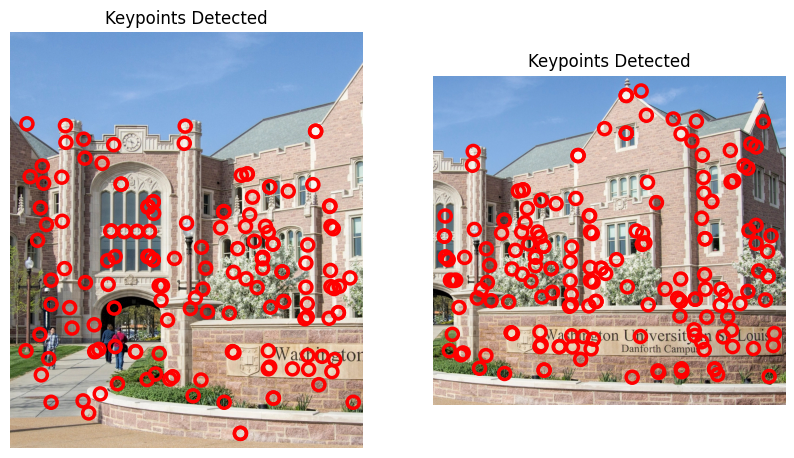

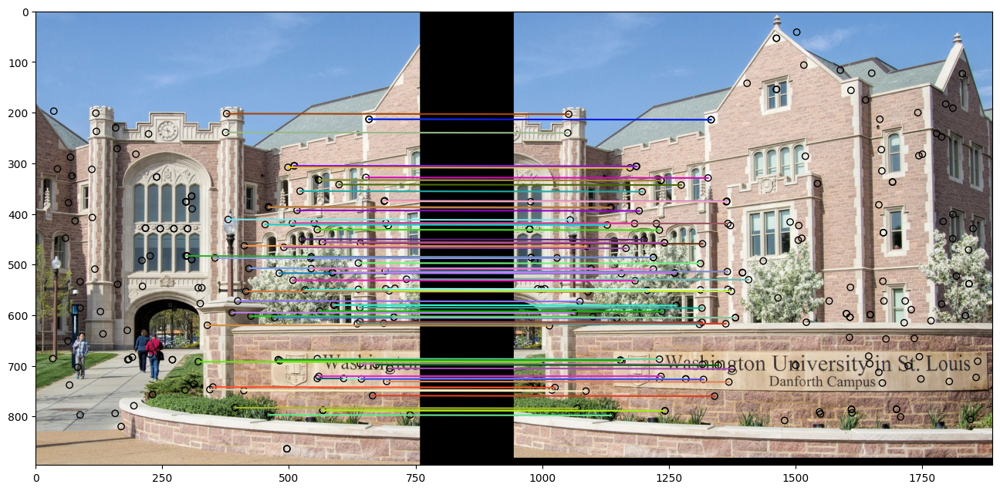

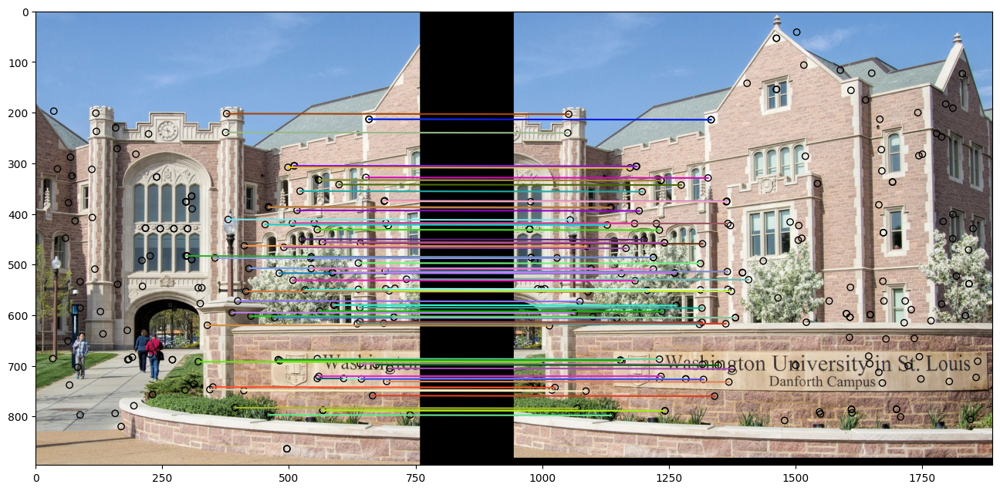

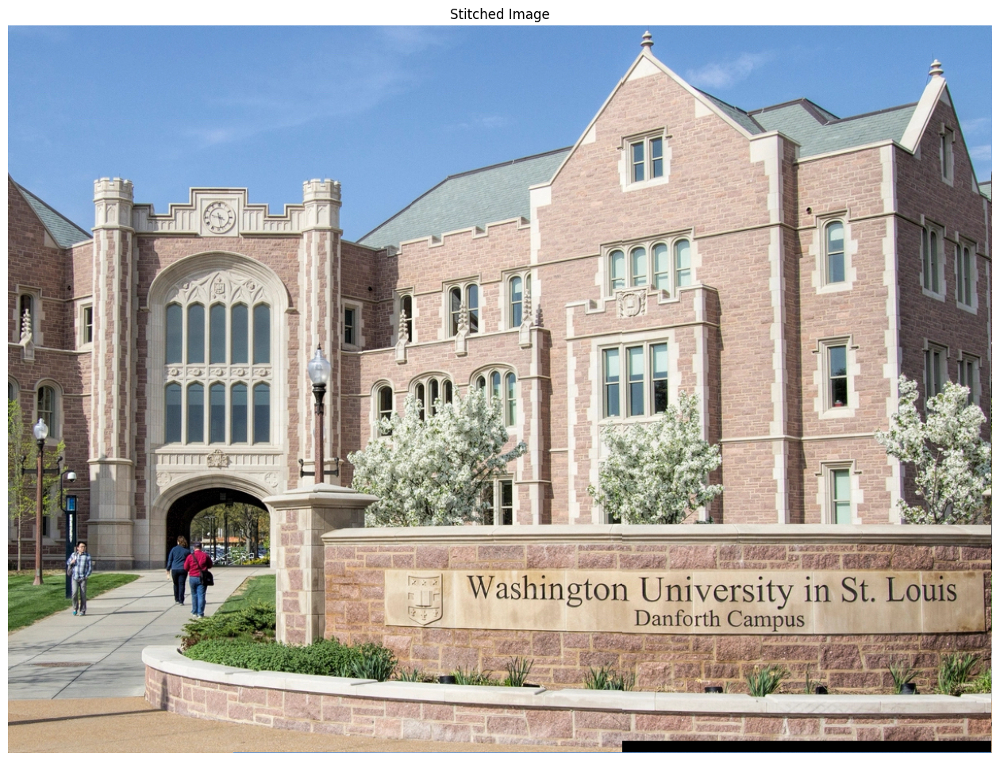

In [34]:

# TODO fix stitching artifacts

config = {'sigma':15,
          'n_octaves':2,
          'max_ratio':0.6,
          'num_iterations':50,
          's':4,
          'RANSAC_threshold':5,
          'transformation': 'affine'
          } 
im1path = "./data/washu_1.jpg"
im2path = "./data/washu_2.jpg"

local_feature_matcher(im1path, im2path, config)

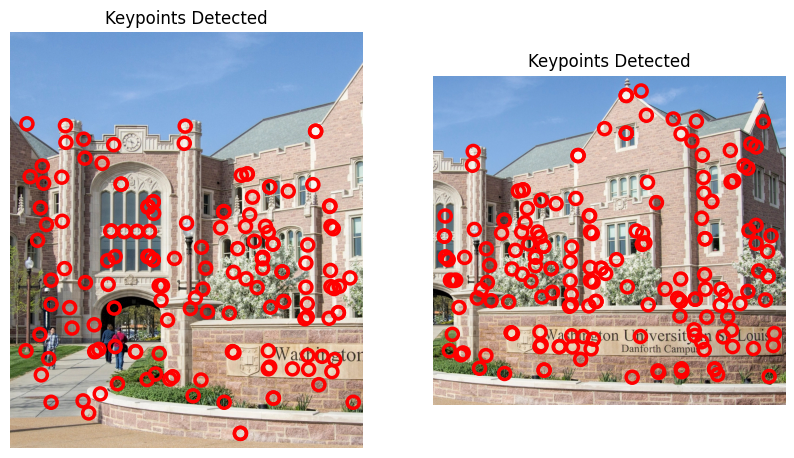

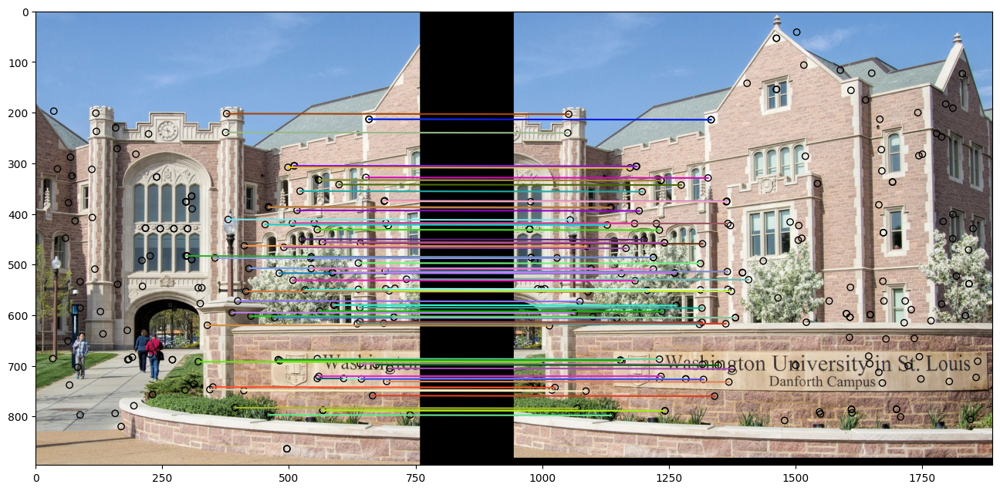

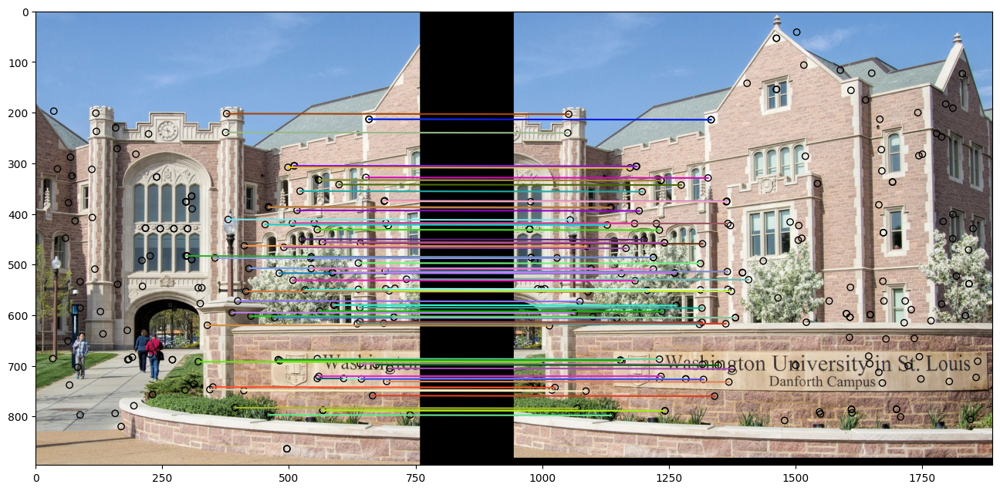

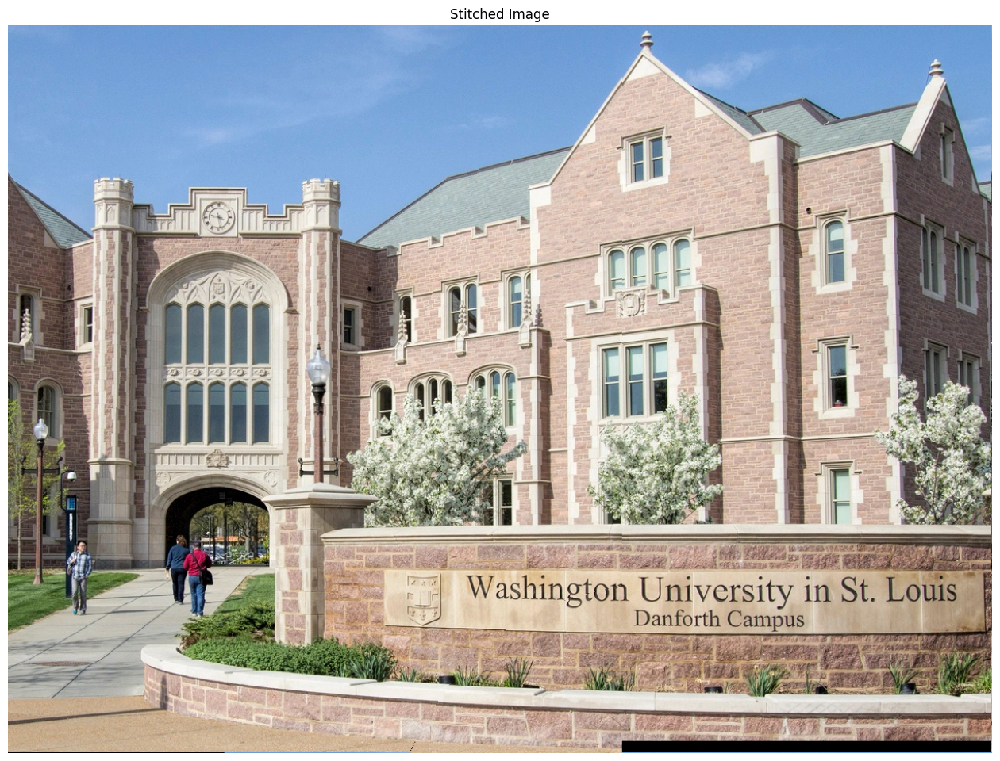

In [35]:
config = {'sigma':15,
          'n_octaves':2,
          'max_ratio':0.6,
          'num_iterations':50,
          's':4,
          'RANSAC_threshold':5,
          'transformation': 'homography'
          } 
im1path = "./data/washu_1.jpg"
im2path = "./data/washu_2.jpg"

local_feature_matcher(im1path, im2path, config)

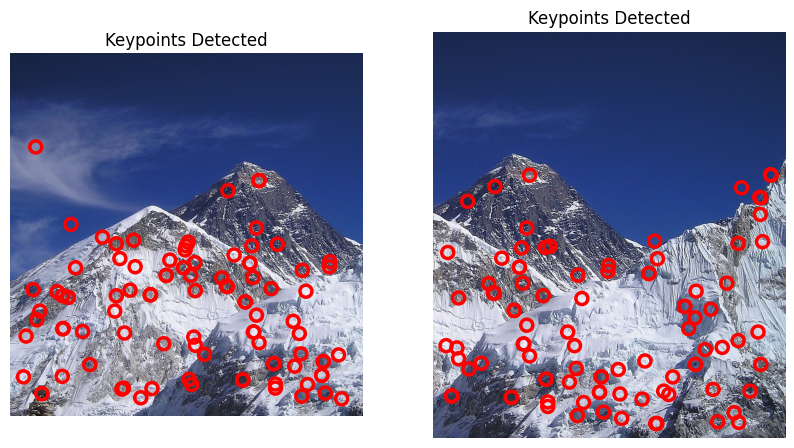

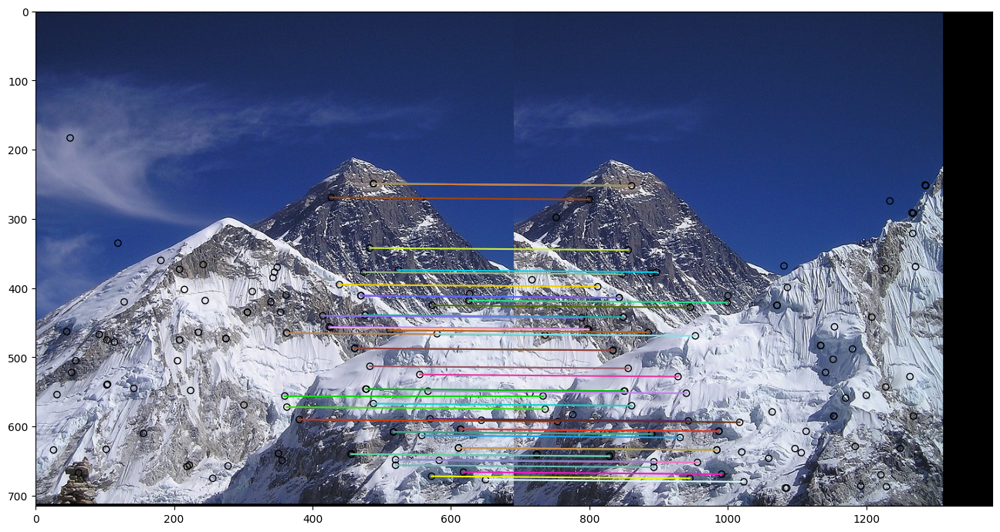

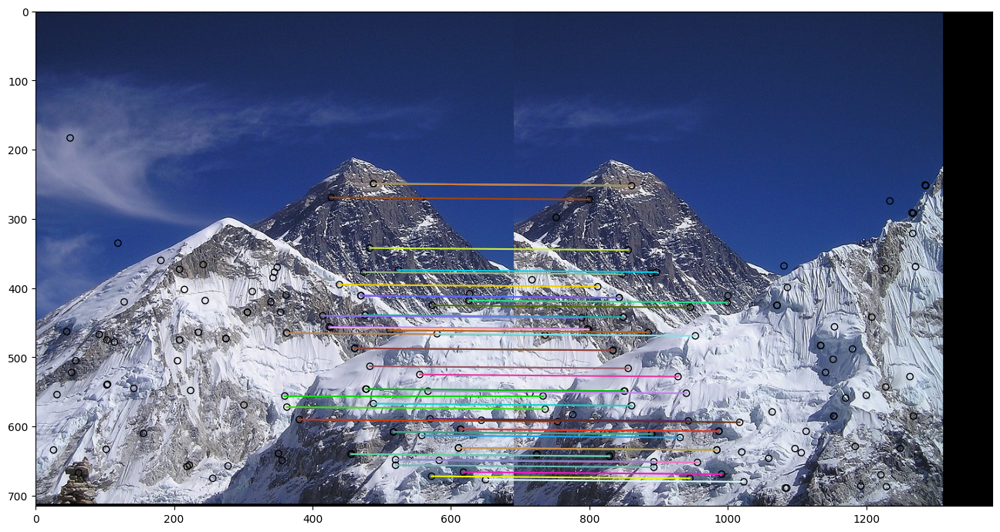

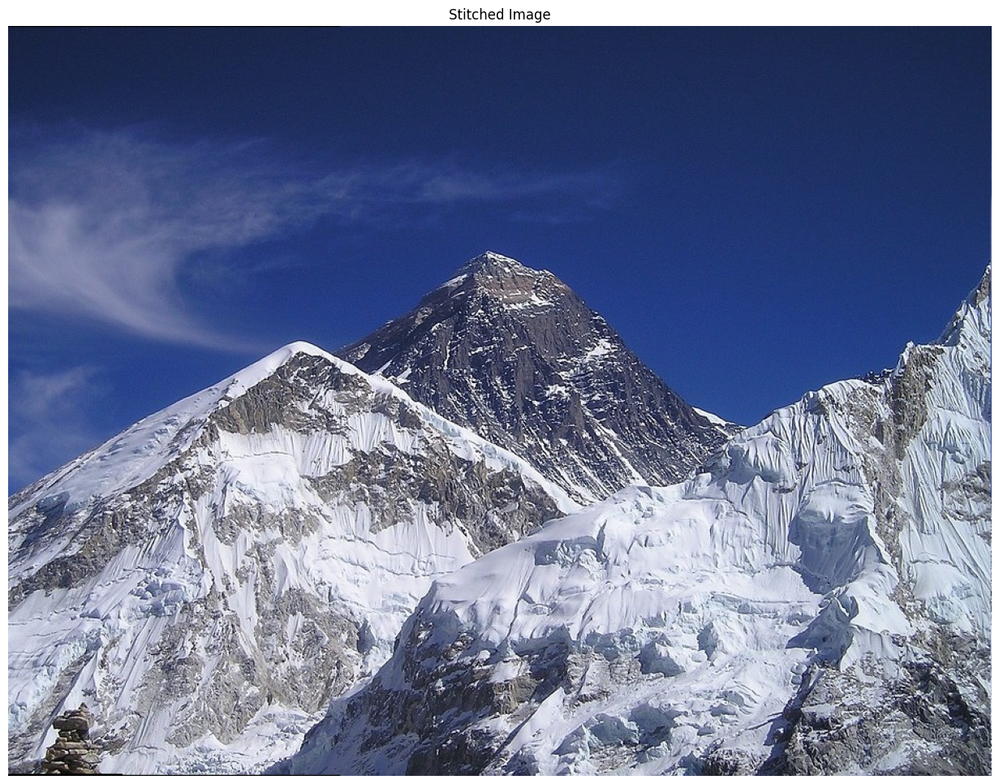

In [36]:
config = {'sigma':15,
          'n_octaves':2,
          'max_ratio':0.6,
          'num_iterations':50,
          's':4,
          'RANSAC_threshold':5,
          'transformation': 'affine'
          }

im1path = "./data/mountEverest_1.jpg"
im2path = "./data/mountEverest_2.jpg"

local_feature_matcher(im1path, im2path, config)

## 3D Reconstruction using RANSAC and Triangulation (Optional)

In this section, we will use the inlier matches obtained from RANSAC to perform a simple 3D reconstruction. The steps are as follows:
1. Use SIFT to extract robust local features (keypoints and descriptors) from both the left and right images. These features capture important image details invariant to scale and rotation, serving as the basis for finding correspondences between the two views.
2. Match the features between the two images using a ratio test to filter out weak matches. This step ensures that we only consider strong correspondences for further processing.
3. Use the inlier matches obtained from RANSAC to triangulate the 3D points. This involves using the camera projection matrices derived from the image alignment process to back-project the 2D points into 3D space.
4. The triangulation process will yield a set of 3D points that represent the scene structure.

This part of the assignment is not mandatory. **You will not be graded on this part**

In [37]:
# !pip install opencv-python

### Triangulation of 3D points
The function `triangulate_points_from_matches` computes the 3D coordinates from stereo keypoint matches as follows:

First, it constructs the left and right camera projection matrices:
\[
\begin{align}
P_1 &= K_{\text{left}} \begin{bmatrix} I & 0 \end{bmatrix}, \\
P_2 &= K_{\text{right}} \begin{bmatrix} R & T \end{bmatrix}.
\end{align}
\]

Given corresponding image points x_1 and x_2 (in homogeneous coordinates), the 4D point X = [X, Y, Z, W]^T satisfies:
\[
\begin{align}
x_1 &\sim P_1 X, \\
x_2 &\sim P_2 X.
\end{align}
\]

Finally, the Euclidean 3D coordinates are obtained by dehomogenizing:
\[
\begin{align}
[X, Y, Z] &= \left[\frac{X}{W}, \frac{Y}{W}, \frac{Z}{W}\right].
\end{align}
\]


In [38]:
import cv2
def triangulate_points_from_matches(kp1, kp2, matches, K_left, K_right, R, T):
    pts_left = []
    pts_right = []
    for m in matches:
        index = int(m)
        pts_left.append(kp1[index])
        pts_right.append(kp2[index])
    
    pts_left = np.float32(pts_left).T
    pts_right = np.float32(pts_right).T 
    
    # Use cv2.triangulatePoints to triangulate the points
    P1 = K_left @ np.hstack((np.eye(3), np.zeros((3, 1))))
    P2 = K_right @ np.hstack((R, T.reshape(3, 1)))
    
    points_4D = cv2.triangulatePoints(P1, P2, pts_left, pts_right)
    points_3D = (points_4D / points_4D[3])[:3].T  # Change from homogeneous coordinates to 3D points
    return points_3D


### Pipeline for triangulating points
Now Generate the pipeline for triangulating points from matches using the camera parameters and the rotation and translation matrices.

In [39]:
def estimate_3D_locations_sift(image_left, image_right, camera_params):
    gray_left = cv2.cvtColor(image_left, cv2.COLOR_BGR2GRAY)
    gray_right = cv2.cvtColor(image_right, cv2.COLOR_BGR2GRAY)
    
    # 1. get SIFT features and descriptors
    kp1, des1 = get_sift_features(gray_left)
    kp2, des2 = get_sift_features(gray_right)
    
    # 2. match descriptors
    matches = match_descriptors(des1, des2)
    if len(matches) < 8:
        raise ValueError("Not enough matches found to compute 3D points.")
    
    # 3. Estimate the transformation using RANSAC
    H, inlier_matches = RANSAC(kp1, kp2, matches)
    if len(inlier_matches) < 8:
        raise ValueError("Not enough inliers found to compute 3D points.")
    
    # 4. Compute the rotation and translation from the homography matrix
    points_3D = triangulate_points_from_matches(kp1, kp2, inlier_matches,
                                                camera_params['K_left'],
                                                camera_params['K_right'],
                                                camera_params['R'],
                                                camera_params['T'])
    return points_3D, kp1, kp2, matches[inlier_matches]

### Visualization

After the 3D points are triangulated, you can visualize the results using a 3D scatter plot. This will show the matched points in 3D space, allowing you to see the structure of the scene captured by the two images.


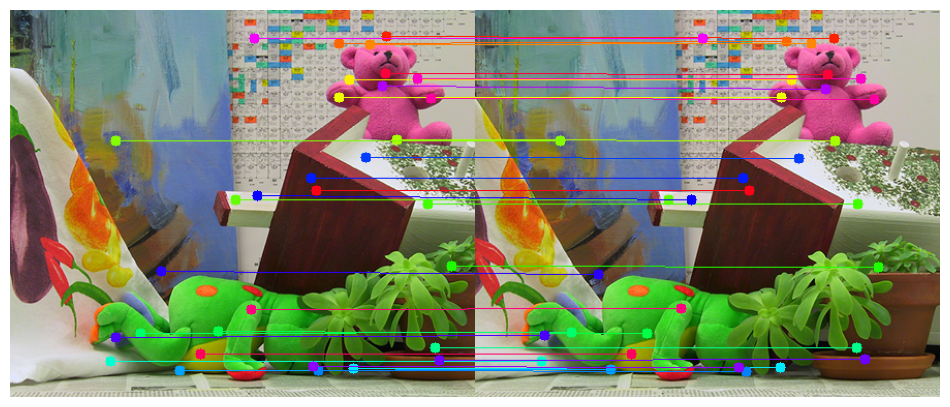

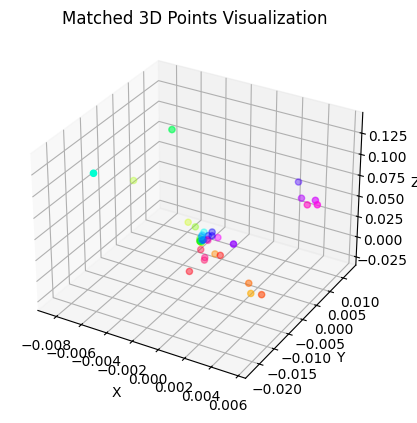

In [40]:
image_left = cv2.imread("./data/im2.png") # [1] 2003 Stereo datasets
image_right = cv2.imread("./data/im6.png") 

# Camera parameters
camera_params = {
    'K_left': np.array([[800, 0, 225],
                        [0, 800, 187.5],
                        [0,   0,   1]]),
    'K_right': np.array([[800, 0, 225],
                         [0, 800, 187.5],
                         [0,   0,   1]]),
    'R': np.eye(3),             # Suppose No rotation between the cameras for simplicity
    'T': np.array([0.005, 0, 0]) # Suppose the translation between the cameras is 1cm along the x-axis
}

# Estimate 3D locations from the stereo images
points_3D, kp1, kp2, inlier_matches = estimate_3D_locations_sift(image_left, image_right, camera_params)

# Update the show_matches function to visualize the matches with colors
def show_matches_color(image_left, image_right, kp1, kp2, matches):
    height = max(image_left.shape[0], image_right.shape[0])
    width = image_left.shape[1] + image_right.shape[1]
    combined_img = np.zeros((height, width, 3), dtype=image_left.dtype)
    combined_img[:image_left.shape[0], :image_left.shape[1]] = image_left
    combined_img[:image_right.shape[0], image_left.shape[1]:] = image_right
    num_matches = len(matches)
    cmap = plt.get_cmap('hsv', num_matches)
    colors = [cmap(i) for i in range(num_matches)] 
    colors_bgr = []
    for color in colors:
        r, g, b, _ = color
        colors_bgr.append((int(b*255), int(g*255), int(r*255)))

    for idx, (i, j) in enumerate(matches):
        pt1 = (int(kp1[i][1]), int(kp1[i][0]))
        pt2 = (int(kp2[j][1] + image_left.shape[1]), int(kp2[j][0]))
        cv2.circle(combined_img, pt1, 5, colors_bgr[idx], -1)
        cv2.circle(combined_img, pt2, 5, colors_bgr[idx], -1)
        cv2.line(combined_img, pt1, pt2, colors_bgr[idx], 1)
    return combined_img, colors 

combined_img, match_colors = show_matches_color(image_left, image_right, kp1, kp2, inlier_matches)
plt.figure(figsize=(12, 6))
plt.imshow(cv2.cvtColor(combined_img, cv2.COLOR_BGR2RGB))
plt.title("")
plt.axis('off')
plt.show()

# Visualize the 3D points with colors corresponding to matches
colors_3d = [color[:3] for color in match_colors]
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(points_3D[:,0], points_3D[:,1], points_3D[:,2], c=colors_3d, marker='o')
ax.set_title("Matched 3D Points Visualization")
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
plt.show()


## AI Usage Summary

[as per course policy, we allow the use of AI assistants as part of completing homework assignments, however such usage must be acknowledged. If it is detected and not acknowledged, it will be considered a violation of academic integrity. As such, please summarize what AI tools you used to complete this assignment, including for understanding the concepts and generating source code. If you used code generation, please explain the extent to which you had to modify the solution for it to function correctly.]

## Credits
Assignment developed by Nathan Jacobs.

3D resconstruction part developed by Dijkstra Liu.

## References
[1]D. Scharstein and R. Szeliski. High-accuracy stereo depth maps using structured light.
In IEEE Computer Society Conference on Computer Vision and Pattern Recognition (CVPR 2003), volume 1, pages 195-202, Madison, WI, June 2003.